In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from torchvision.transforms import Resize
import torchvision.transforms as transforms
import torchvision 
from torchvision.models import vgg19, VGG19_Weights
import copy

import torch
import plenoptic as po
import scipy.io as sio
import os
import os.path as op
import einops
from typing import Union, Tuple, Callable, List, Dict, Optional
import glob
import math
import pyrtools as pt
from tqdm import tqdm
from PIL import Image
import sys
from collections import OrderedDict
sys.path.append('../src/plenoptic/tools/')
from plenoptic.tools import img_transforms 
%load_ext autoreload
%autoreload 

# We need to download some additional images for this notebook. In order to do so,
# we use an optional dependency, pooch. If the following raises an ImportError or ModuleNotFoundError 
# then install pooch in your plenoptic environment and restart your kernel.
DATA_PATH = po.data.fetch_data('portilla_simoncelli_images.tar.gz')
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.set_default_device(DEVICE)    

# so that relative sizes of axes created by po.imshow and others look right
plt.rcParams['figure.dpi'] = 72

# set seed for reproducibility
po.tools.set_seed(1)

100%|█████████████████████████████████████| 1.29M/1.29M [00:00<00:00, 2.24GB/s]
Untarring contents of '/dev/shm/.cache-hdettki/plenoptic/portilla_simoncelli_images.tar.gz' to '/dev/shm/.cache-hdettki/plenoptic/portilla_simoncelli_images.tar.gz.untar'


# Style Transfer Example and Comparison to Portilla-Simoncelli Model
Style transfer takes 3 inputs:
- content image
- style image
- input image (init with noise)

## Underlying Principle:
2 Distances, one for content, one for style. Third input image is transformed such that it will minimize both distances.

To compare it to the Portilla-Simoncelli Model, we will input the same image for both content and style.

In [2]:
# desired size of the output image
#imsize = 256 if torch.cuda.is_available() else 128  # use small size if no GPU

loader = transforms.Compose([
    transforms.Resize((256, 256)),  # resize to 256x256
    transforms.ToTensor()])  # transform it into a torch tensor


def image_loader(image_name):
    image = Image.open(image_name)
    # fake batch dimension required to fit network's input dimensions
    image = loader(image).unsqueeze(0)
    return image.to(DEVICE, torch.float)

path_to_unsplash = '../../../ceph/Datasets/select_color_textures_unsplash'
beeds = image_loader(op.join(path_to_unsplash, 'catrin-johnson-PleATApY2Lk-unsplash.jpg'))
rope = image_loader(op.join(path_to_unsplash, 'emmanuel-ben-paul-R_k6kaHhHnY-unsplash.jpg'))
flowers = image_loader(op.join(path_to_unsplash, 'wolfgang-hasselmann-HxwPps61C58-unsplash.jpg'))
honey = image_loader(op.join(path_to_unsplash, 'jonas-hensel-3Cpws7ibtfo-unsplash.jpg'))
bamboo = image_loader(op.join(path_to_unsplash, 'franco-mariuzza-QbDXTPCB4Q0-unsplash.jpg'))
wood = image_loader(op.join(path_to_unsplash, 'collab-media-D38yYE8Ly_k-unsplash.jpg'))
leaf = image_loader(op.join(path_to_unsplash, 'david-clode-ebnRCk34Myw-unsplash.jpg'))
windows = image_loader(op.join(path_to_unsplash, 'mihaly-koles-8V_cLUyJnx8-unsplash.jpg'))
hay = image_loader(op.join(path_to_unsplash, 'lucas-gallone-9Mq_Q-4gs-w-unsplash.jpg'))

# define content image and style image
content_img = beeds
style_img = beeds

In [3]:
assert style_img.size() == content_img.size(),\
    "we need to import style and content images of the same size"
content_img.shape, style_img.shape



(torch.Size([1, 3, 256, 256]), torch.Size([1, 3, 256, 256]))

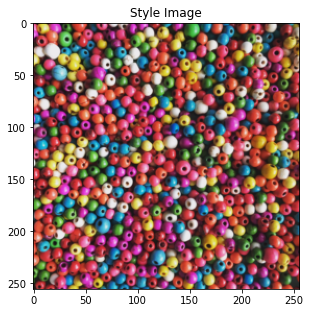

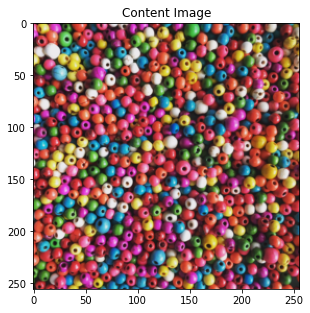

In [4]:
# po.imshow(content_img, as_rgb=True)
# po.imshow(style_img, as_rgb=True)

unloader = transforms.ToPILImage()  # reconvert into PIL image

plt.ion()

def imshow(tensor, title=None):
    image = tensor.cpu().clone()  # we clone the tensor to not do changes on it
    image = image.squeeze(0)      # remove the fake batch dimension
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) # pause a bit so that plots are updated


plt.figure()
imshow(style_img, title='Style Image')

plt.figure()
imshow(content_img, title='Content Image')


## Loss Functions

### Content Loss
- function represents a weighted version of the content distance for an individual layer
- will immediately follow after conv layers that are being used to compute the content distance.
    - -> each time the NN is fed an input image, the content losses will be computed at the desired layers (because of autograd all the gradients will be computed).

In [5]:
class ContentLoss(torch.nn.Module):

    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        # we 'detach' the target content from the tree used
        # to dynamically compute the gradient: this is a stated value,
        # not a variable. Otherwise the forward method of the criterion
        # will throw an error.
        self.target = target.detach()

    def forward(self, input):
        self.loss = torch.nn.functional.mse_loss(input, self.target)
        return input

## Style Loss 
- similar to content loss but on Gram Marix (result of multiplying a given matrix by its transposed version), then normalized

In [6]:


def gram_matrix(input):
    a, b, c, d = input.size()  # a=batch size(=1)
    # b=number of feature maps
    # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d)  # resize F_XL into \hat F_XL

    G = torch.mm(features, features.t())  # compute the gram product

    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G.div(a * b * c * d)


In [7]:
class StyleLoss(torch.nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = torch.nn.functional.mse_loss(G, self.target)
        return input

## Importing a pretrained model 

In [8]:
from torchvision.models import vgg19, VGG19_Weights
cnn = vgg19(weights=VGG19_Weights.DEFAULT, progress=True).features.to(DEVICE).eval()

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /dev/shm/.cache-hdettki/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:12<00:00, 47.6MB/s] 


### Normalization 

In [9]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406])
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225])

# create a module to normalize input image so we can easily put it in a
# ``nn.Sequential``
class Normalization(torch.nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # .view the mean and std to make them [C x 1 x 1] so that they can
        # directly work with image Tensor of shape [B x C x H x W].
        # B is batch size. C is number of channels. H is height and W is width.
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        # normalize ``img``
        return (img - self.mean) / self.std

### Adding our Content and Style Loss

In [10]:
# desired depth layers to compute style/content losses :
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

def get_style_model_and_losses(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    # normalization module
    normalization = Normalization(normalization_mean, normalization_std)

    # just in order to have an iterable access to or list of content/style
    # losses
    content_losses = []
    style_losses = []

    # assuming that ``cnn`` is a ``nn.Sequential``, so we make a new ``nn.Sequential``
    # to put in modules that are supposed to be activated sequentially
    model = torch.nn.Sequential(normalization)

    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, torch.nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, torch.nn.ReLU):
            name = 'relu_{}'.format(i)
            # The in-place version doesn't play very nicely with the ``ContentLoss``
            # and ``StyleLoss`` we insert below. So we replace with out-of-place
            # ones here.
            layer = torch.nn.ReLU(inplace=False)
        elif isinstance(layer, torch.nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, torch.nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

Select input image

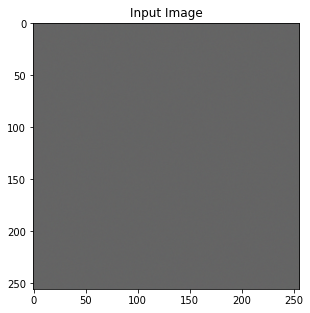

In [11]:
#input_img = content_img.clone()

input_img=torch.rand_like(content_img[:,:,:]) * .01 + content_img.mean()
# if you want to use white noise by using the following code:
#
# .. code-block:: python
#
#    input_img = torch.randn(content_img.data.size())

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')

### Gradient Descent
- using L-BFGS algorithm

In [12]:
def get_input_optimizer(input_img):
    # this line to show that input is a parameter that requires a gradient
    optimizer = torch.optim.LBFGS([input_img])
    return optimizer

In [13]:
def run_style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, num_steps=300,
                       style_weight=1000000, content_weight=1):
    """Run the style transfer."""
    print('Building the style transfer model..')
    model, style_losses, content_losses = get_style_model_and_losses(cnn,
        normalization_mean, normalization_std, style_img, content_img)

    # We want to optimize the input and not the model parameters so we
    # update all the requires_grad fields accordingly
    input_img.requires_grad_(True)
    # We also put the model in evaluation mode, so that specific layers
    # such as dropout or batch normalization layers behave correctly.
    model.eval()
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_img)

    print('Optimizing..')
    run = [0]
    while run[0] <= num_steps:

        def closure():
            # correct the values of updated input image
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            style_score = 0
            content_score = 0

            for sl in style_losses:
                style_score += sl.loss
            for cl in content_losses:
                content_score += cl.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print("run {}:".format(run))
                print('Style Loss : {:4f} Content Loss: {:4f}'.format(
                    style_score.item(), content_score.item()))
                print()

            return style_score + content_score

        optimizer.step(closure)

    # a last correction...
    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img

Building the style transfer model..


/mnt/home/hdettki/.virtualenvs/plenoptic/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Optimizing..
run [50]:
Style Loss : 2480.802246 Content Loss: 177.027573

run [100]:
Style Loss : 232.949753 Content Loss: 175.522247

run [150]:
Style Loss : 72.370834 Content Loss: 167.844757

run [200]:
Style Loss : 33.391655 Content Loss: 156.392532

run [250]:
Style Loss : 21.608015 Content Loss: 142.326721

run [300]:
Style Loss : 16.410536 Content Loss: 127.699203



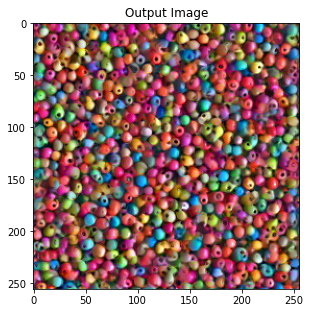

In [14]:
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img)

plt.figure()
imshow(output, title='Output Image')

plt.ioff()
plt.show()

### Let's run Style Transfer on the same batch as the Portilla-Simoncelli Model

In [15]:
image_files = glob.glob(os.path.join(path_to_unsplash, '*.jpg'))  # Assuming images are in .jpg format
image_files.extend(glob.glob(os.path.join(path_to_unsplash, '*.png')))  # Include .png format as well

# Step 2: Load the images
images = []
for image_file in image_files:
    try:
        img = Image.open(image_file)
        images.append(img)
    except Exception as e:
        print(f"Error loading image {image_file}: {e}")

# transform the images to tensors and then resize them to 256x256
#images = [torch.tensor(np.array(img)).permute(2, 0, 1).unsqueeze(0).float() / 255.0 for img in images]
# Define a sequence of transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # resize to 256x256
    transforms.ToTensor(),  # Convert to tensor
])

# Apply the transformations
img_tensor_ls = []
for img in images:
    img_tensor_ls.append(transform(img))

img_tensor = torch.stack(img_tensor_ls, dim=0) # stack the images along the batch dimension
# send images to GPU, if available
img_tensor = img_tensor.to(DEVICE)
img_tensor.shape

torch.Size([12, 3, 256, 256])

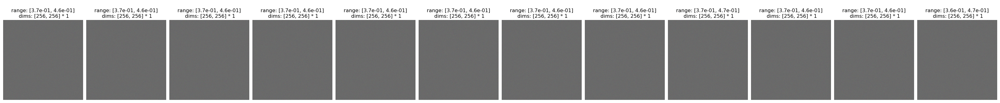

In [16]:
content_imgs = img_tensor.clone()
style_imgs = img_tensor.clone()
# create an input image batch based on gaussian noise for each content image
#input_img=torch.rand_like(content_img[:,:,:]) * .01 + content_img.mean()

input_imgs = torch.randn_like(content_imgs[:,:,:]) * 0.01 + content_imgs.mean()
input_imgs.shape

po.imshow(input_imgs, as_rgb=True)


Building the style transfer model..
Optimizing..


run [50]:
Style Loss : 5.779788 Content Loss: 15.520946

run [100]:
Style Loss : 1.404942 Content Loss: 3.208475

run [150]:
Style Loss : 0.703490 Content Loss: 1.129014

run [200]:
Style Loss : 0.373148 Content Loss: 0.595425

run [250]:
Style Loss : 0.177927 Content Loss: 0.357885

run [300]:
Style Loss : 0.097229 Content Loss: 0.241671



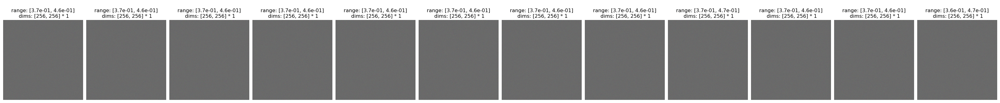

<Figure size 460.8x345.6 with 0 Axes>

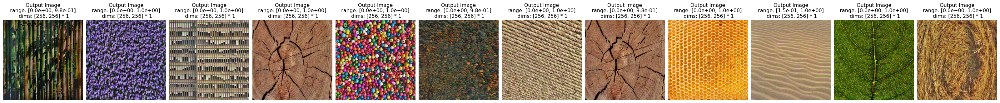

In [17]:
output_batch = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_imgs, style_imgs, input_imgs)

plt.figure()
po.imshow(output_batch, title='Output Image', as_rgb=True)

plt.ioff()
plt.show()

<Figure size 460.8x345.6 with 0 Axes>

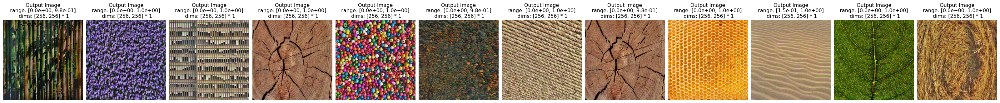

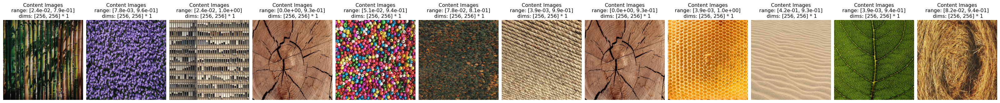

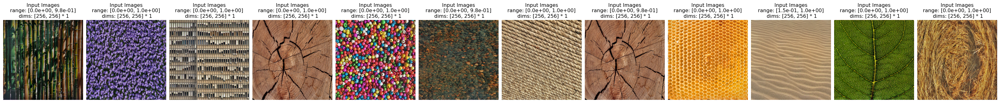

In [18]:
plt.figure()
po.imshow(output_batch, title='Output Image', as_rgb=True)
po.imshow(content_imgs, title='Content Images', as_rgb=True)
po.imshow(input_imgs, title='Input Images', as_rgb=True)


plt.ioff()
plt.show()

### Different Style and Content images


In [28]:
content_imgs = img_tensor.clone()
style_img = img_tensor[0,None,:,:,:].clone() # bamboo style: batch size of 1
# Repeat the tensor 12 times along the batch dimension (12, 3, 256, 256)
style_imgs = style_img.repeat(12, 1, 1, 1)

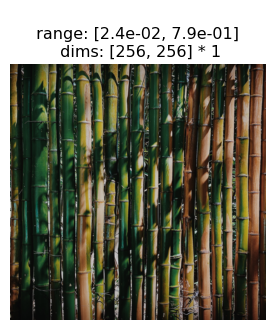

In [23]:
po.imshow(style_imgs[None,:,:,:], as_rgb=True)

Building the style transfer model..
Optimizing..


/mnt/home/hdettki/.virtualenvs/plenoptic/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


run [50]:
Style Loss : 11.766879 Content Loss: 27.371048

run [100]:
Style Loss : 7.832411 Content Loss: 25.304813

run [150]:
Style Loss : 6.687882 Content Loss: 25.174877

run [200]:
Style Loss : 10.984365 Content Loss: 28.911160

run [250]:
Style Loss : 6.390616 Content Loss: 25.044134

run [300]:
Style Loss : 7.882730 Content Loss: 24.893307



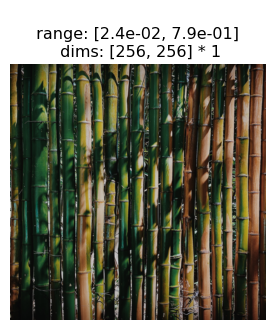

<Figure size 460.8x345.6 with 0 Axes>

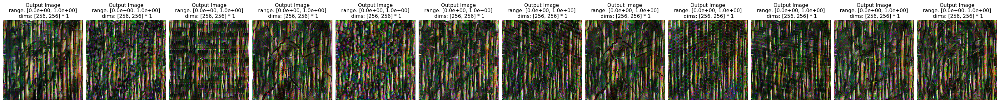

In [29]:
output_batch = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_imgs, style_imgs, input_imgs)

plt.figure()
po.imshow(output_batch, title='Output Image', as_rgb=True)

plt.ioff()
plt.show()

In [31]:
content_imgs = img_tensor.clone()
style_img = img_tensor[-3,None,:,:,:].clone() # sand style: batch size of 1
# Repeat the tensor 12 times along the batch dimension (12, 3, 256, 256)
style_imgs = style_img.repeat(12, 1, 1, 1)

Building the style transfer model..
Optimizing..


/mnt/home/hdettki/.virtualenvs/plenoptic/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


run [50]:
Style Loss : 9.398990 Content Loss: 18.669767

run [100]:
Style Loss : 7.857128 Content Loss: 17.693365

run [150]:
Style Loss : 7.256184 Content Loss: 17.312361

run [200]:
Style Loss : 6.878689 Content Loss: 17.090307

run [250]:
Style Loss : 6.598136 Content Loss: 16.935461

run [300]:
Style Loss : 6.383042 Content Loss: 16.820438



<Figure size 460.8x345.6 with 0 Axes>

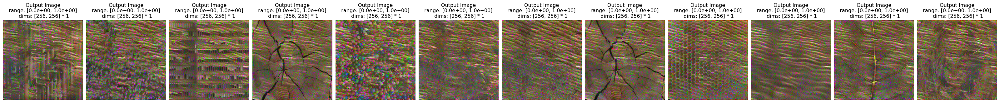

In [32]:
output_batch = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_imgs, style_imgs, input_imgs)

plt.figure()
po.imshow(output_batch, title='Output Image', as_rgb=True)

plt.ioff()
plt.show()